In [2]:
!pip install segmentation_models_pytorch

import cv2
import os
import numpy as np
from glob import glob
import albumentations as A
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import segmentation_models_pytorch as smp
from albumentations.pytorch import ToTensorV2
from matplotlib import pyplot as plt

In [2]:
import cv2
import os
import numpy as np
from glob import glob
import albumentations as A

# Input & output paths
image_dir = "C:/Users/saval/Downloads/toilet"
mask_dir = "C:/Users/saval/Downloads/toilet_marked"

aug_img_dir = "C:/Users/saval/Downloads/toilet_aug/images"
aug_mask_dir = "C:/Users/saval/Downloads/toilet_aug/marked"
os.makedirs(aug_img_dir, exist_ok=True)
os.makedirs(aug_mask_dir, exist_ok=True)

# Define deterministic transformations
augmentations = [
    A.HorizontalFlip(p=1.0),
    A.VerticalFlip(p=1.0),
    A.RandomRotate90(p=1.0),
    A.RandomBrightnessContrast(p=1.0),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=10, p=1.0),
    A.GaussNoise(p=1.0),
    # Combo: brightness + noise
    A.Compose([
        A.RandomBrightnessContrast(p=1.0),
        A.GaussNoise(p=1.0),
    ]),
    # Combo: flip + shift + rotate
    A.Compose([
        A.HorizontalFlip(p=1.0),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=10, p=1.0)
    ])
]

# Run augmentation
image_paths = sorted(glob(os.path.join(image_dir, "*.jpg")))

for img_path in image_paths:
    base = os.path.basename(img_path).split('.')[0]
    mask_path = os.path.join(mask_dir, f"{base}.jpg")

    if not os.path.exists(mask_path):
        print(f"Skipping {base} due to missing mask.")
        continue

    # Load image and mask
    image = cv2.imread(img_path)
    mask = cv2.imread(mask_path)

    # Apply all defined augmentations
    for i, aug in enumerate(augmentations):
        augmented = aug(image=image, mask=mask)
        aug_img = augmented['image']
        aug_mask = augmented['mask']

        # Save results
        cv2.imwrite(os.path.join(aug_img_dir, f"{base}_aug{i}.jpg"), aug_img)
        cv2.imwrite(os.path.join(aug_mask_dir, f"{base}_aug{i}_marked.png"), aug_mask)

print("✅ All augmentations applied successfully!")


✅ All augmentations applied successfully!


In [ ]:
# --- 1. Setup & Install ---
!pip install segmentation-models-pytorch albumentations --quiet

# --- 2. Imports ---
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import segmentation_models_pytorch as smp
import albumentations as A
from albumentations.pytorch import ToTensorV2
from matplotlib import pyplot as plt

# --- 3. Constants ---
IMG_DIR = 'C:/Users/saval/Downloads/toilet_aug/images'
MASK_DIR = 'C:/Users/saval/Downloads/toilet_aug/marked'
BATCH_SIZE = 8
IMG_SIZE = 256
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

# --- 4. Strict Red Line Extractor ---
def extract_red_lines(mask_img):
    # Convert RGB to HSV
    hsv = cv2.cvtColor(mask_img, cv2.COLOR_RGB2HSV)

    # Strict red hue range with tight saturation/value constraints
    lower_red2 = np.array([0, 100, 100])
    upper_red2 = np.array([10, 255, 255])

    mask2 = cv2.inRange(hsv, lower_red2, upper_red2)

    return (mask2 > 0).astype(np.uint8)  # Binary mask: 1 for red, 0 elsewhere

# --- 5. Custom Dataset ---
class RimDataset(Dataset):
    def __init__(self, img_dir, mask_dir, transform=None):
        self.img_dir = img_dir
        self.mask_dir = mask_dir
        self.images = [f for f in os.listdir(img_dir) if f.endswith('.jpg')]
        self.transform = transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = self.images[idx]
        base = os.path.splitext(img_name)[0]
        mask_name = f"{base}_marked.png"

        img_path = os.path.join(self.img_dir, img_name)
        mask_path = os.path.join(self.mask_dir, mask_name)

        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        marked = cv2.imread(mask_path)
        marked = cv2.cvtColor(marked, cv2.COLOR_BGR2RGB)

        mask = extract_red_lines(marked).astype(np.float32)

        if self.transform:
            aug = self.transform(image=image, mask=mask)
            image = aug['image']
            mask = aug['mask']

        return image, mask.unsqueeze(0)  # (1, H, W)

# --- 6. Transformations ---
transform = A.Compose([
    A.Resize(IMG_SIZE, IMG_SIZE),
    A.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
    ToTensorV2(),
])

# --- 7. Dataloader ---
dataset = RimDataset(IMG_DIR, MASK_DIR, transform=transform)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)

# --- 8. Model, Loss, Optimizer ---
model = smp.Unet('resnet18', encoder_weights='imagenet', in_channels=3, classes=1).to(DEVICE)
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

# --- 9. Training Loop ---
epochs = 20
for epoch in range(epochs):
    model.train()
    total_loss = 0
    for img, mask in dataloader:
        img, mask = img.to(DEVICE), mask.to(DEVICE)
        pred = model(img)
        loss = criterion(pred, mask)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    print(f"Epoch {epoch+1}/{epochs}, Loss: {total_loss/len(dataloader):.4f}")

# --- 10. Visualization Function ---
def show_prediction(img, pred_mask):
    img = img.permute(1, 2, 0).cpu().numpy()
    img = (img * 0.5 + 0.5) * 255  # denormalize
    img = img.astype(np.uint8)
    pred_mask = torch.sigmoid(pred_mask.squeeze()).cpu().numpy()
    pred_mask = (pred_mask > 0.5).astype(np.uint8) * 255
    overlay = cv2.addWeighted(img, 0.8, cv2.cvtColor(pred_mask, cv2.COLOR_GRAY2RGB), 0.5, 0)
    plt.figure(figsize=(6, 6))
    plt.imshow(overlay)
    plt.axis('off')
    plt.show()

model.eval()

# --- 11. Predict on All Images and Show Masks ---
print("\n📌 Showing predictions on all images in", IMG_DIR)

for i in range(len(dataset)):
    img, _ = dataset[i]  # ignore true mask
    img_input = img.unsqueeze(0).to(DEVICE)

    with torch.no_grad():
        pred_mask = model(img_input)[0]  # (1, H, W)

    # Visualize prediction
    show_prediction(img, pred_mask)


In [4]:
torch.save(model.state_dict(), "toilet_rim_segmentation_model.pth")

In [2]:
!pip install segmentation_models_pytorch

import cv2
import os
import numpy as np
from glob import glob
import albumentations as A
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import segmentation_models_pytorch as smp
from albumentations.pytorch import ToTensorV2
from matplotlib import pyplot as plt

c:\Users\saval\AppData\Local\Programs\Python\Python313\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

# To load the saved model state_dict:
model = smp.Unet('resnet18', encoder_weights='imagenet', in_channels=3, classes=1)
model.load_state_dict(torch.load("toilet_rim_segmentation_model.pth", map_location=DEVICE))
model.to(DEVICE)
model.eval() # Set model to evaluation mode

Unet(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track

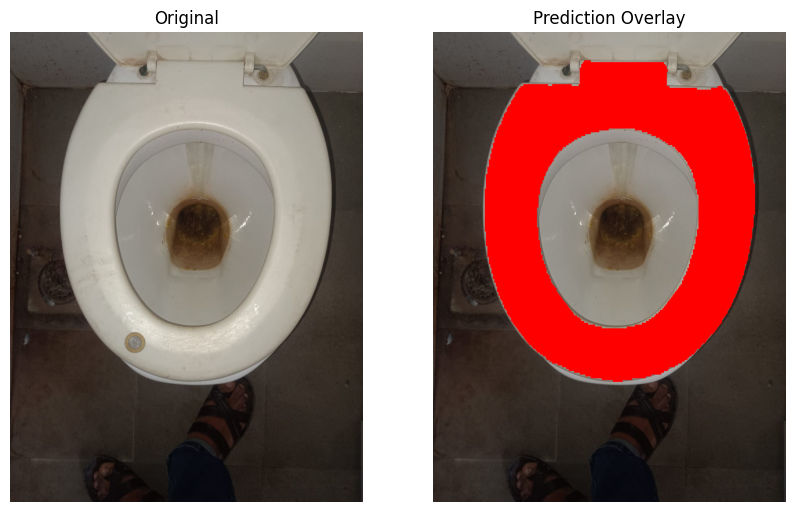

In [9]:
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms

# --- Setup device ---
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# --- Load and preprocess image ---
test_path = "C:/Users/saval/Downloads/toilet/test2.jpg"
test_image = cv2.imread(test_path)
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
resized = cv2.resize(test_image, (256, 256))

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])
input_tensor = transform(resized).unsqueeze(0).to(DEVICE)

# --- Predict ---
model.eval()
with torch.no_grad():
    output = model(input_tensor)
    pred = torch.sigmoid(output).squeeze().cpu().numpy()
    pred_mask = (pred > 0.5).astype(np.uint8) * 255

# --- Resize mask to original size ---
pred_mask_resized = cv2.resize(pred_mask, (test_image.shape[1], test_image.shape[0]))

# --- Overlay mask on image ---
overlay = test_image.copy()
overlay[pred_mask_resized == 255] = [255, 0, 0]

# --- Show results ---
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(test_image)
plt.title("Original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(overlay)
plt.title("Prediction Overlay")
plt.axis("off")
plt.show()


In [ ]:
# --- 1. Imports ---
import os
import cv2
import numpy as np
from matplotlib import pyplot as plt

# --- 2. Constants ---
IMG_DIR = './toilet'
MASK_DIR = './toilet_marked/'  # red-marked overlay images

# --- 3. Red Line Extractor ---
def extract_red_lines(mask_img):
    hsv = cv2.cvtColor(mask_img, cv2.COLOR_RGB2HSV)
    lower_red2 = np.array([0, 100, 100])
    upper_red2 = np.array([10, 255, 255])
    mask2 = cv2.inRange(hsv, lower_red2, upper_red2)
    return mask2  # returns binary mask (0 or 255)

# --- 4. Visualize Red Masks ---
images = [f for f in os.listdir(MASK_DIR) if f.endswith('.jpg')]

for mask_name in images:
    path = os.path.join(MASK_DIR, mask_name)
    marked = cv2.imread(path)
    marked = cv2.cvtColor(marked, cv2.COLOR_BGR2RGB)

    red_mask = extract_red_lines(marked)

    plt.figure(figsize=(6, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(red_mask, cmap='gray')
    plt.title(mask_name)
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(marked, cmap='gray')
    plt.title(mask_name)
    plt.axis('off')
    plt.show()


FileNotFoundError: [WinError 3] The system cannot find the path specified: '/content/marked/'

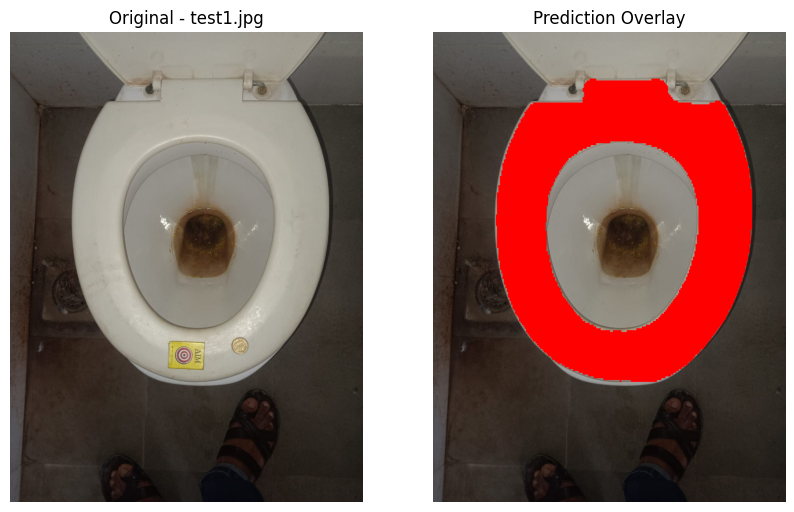

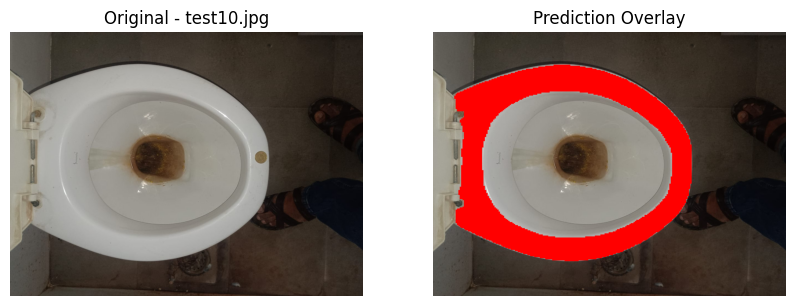

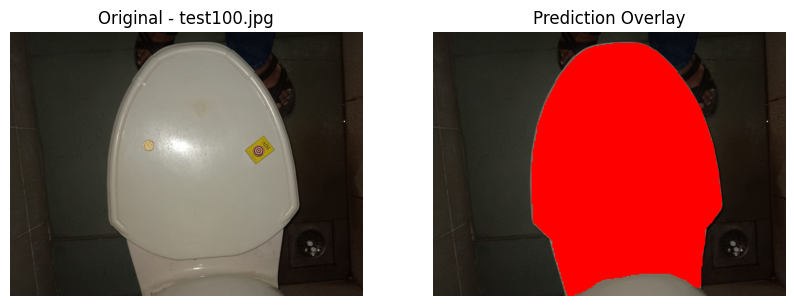

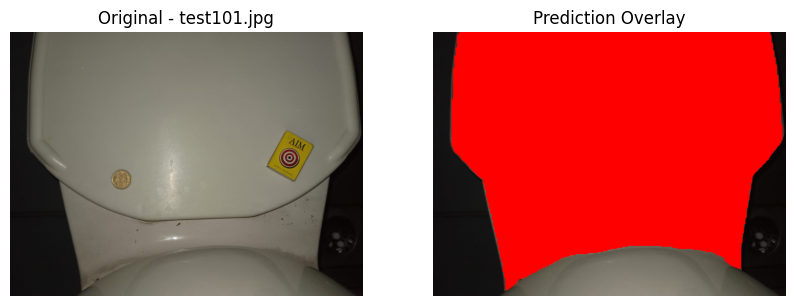

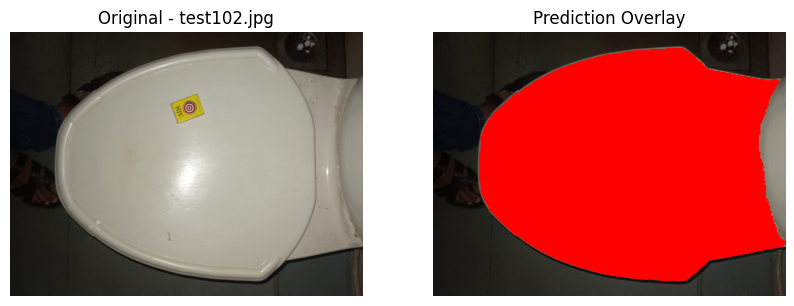

...

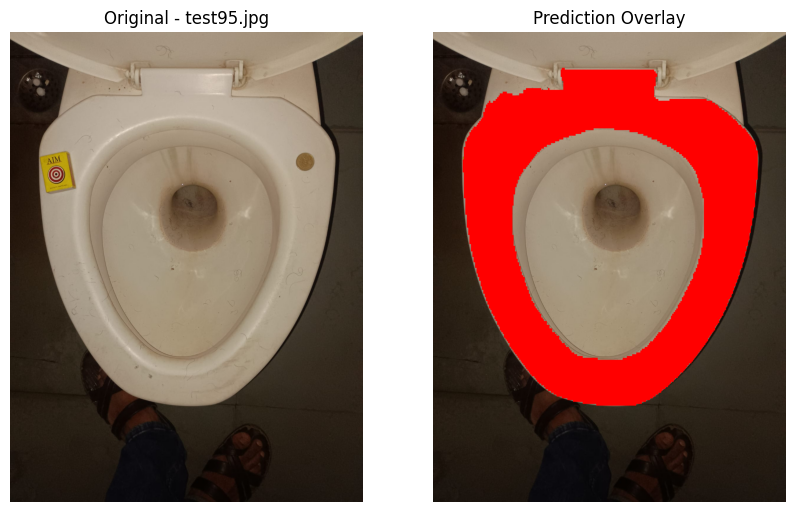

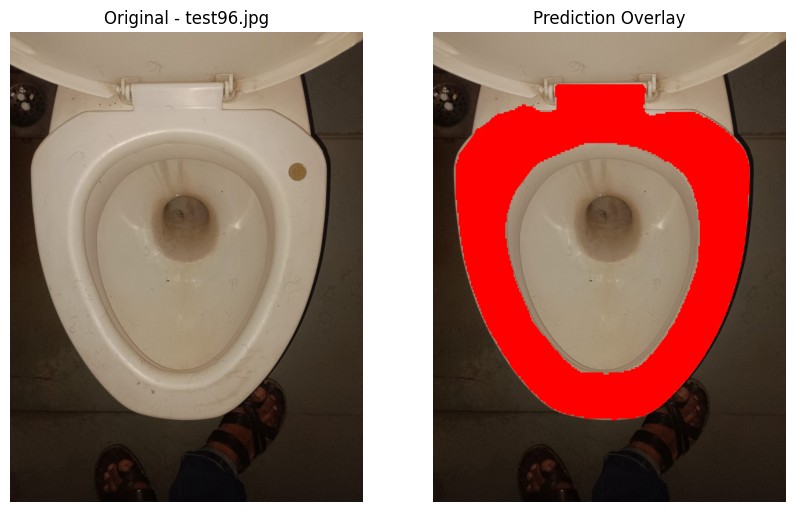

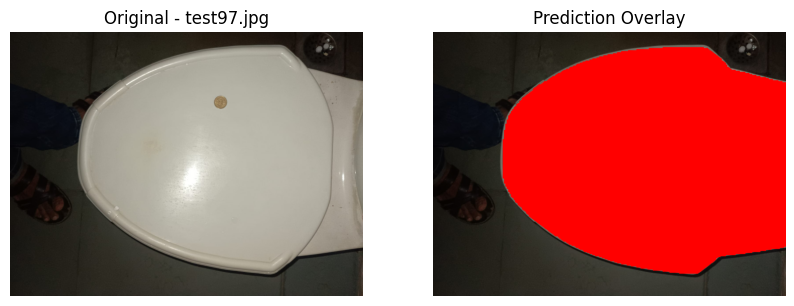

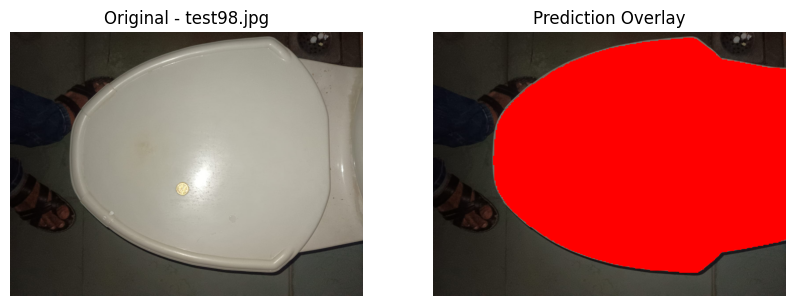

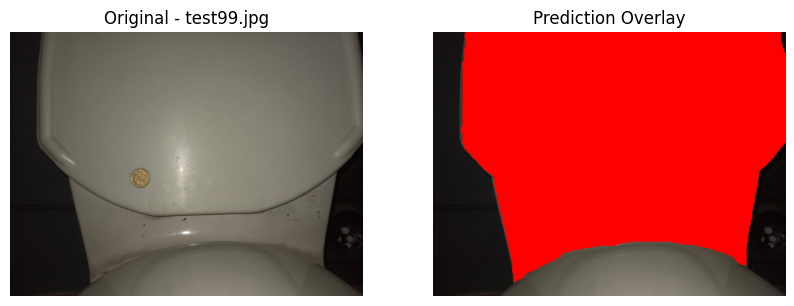

In [ ]:
import os
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms

# --- Setup device ---
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# --- Folder path containing images ---
folder_path = "C:/Users/saval/Downloads/toilet"  # Change this to your folder path

# --- Image transform ---
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

# --- Set model to evaluation mode ---
model.eval()

# --- Process each image in the folder ---
for filename in os.listdir(folder_path):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.webp')):
        image_path = os.path.join(folder_path, filename)
        # Load and preprocess image
        image = cv2.imread(image_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        resized = cv2.resize(image_rgb, (256, 256))
        input_tensor = transform(resized).unsqueeze(0).to(DEVICE)

        # Predict mask
        with torch.no_grad():
            output = model(input_tensor)
            pred = torch.sigmoid(output).squeeze().cpu().numpy()
            pred_mask = (pred > 0.5).astype(np.uint8) * 255

        # Resize mask to original size
        pred_mask_resized = cv2.resize(pred_mask, (image_rgb.shape[1], image_rgb.shape[0]))

        # Overlay mask on image
        overlay = image_rgb.copy()
        overlay[pred_mask_resized == 255] = [255, 0, 0]

        # Show results
        plt.figure(figsize=(10, 10))
        plt.subplot(1, 2, 1)
        plt.imshow(image_rgb)
        plt.title(f"Original - {filename}")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(overlay)
        plt.title("Prediction Overlay")
        plt.axis("off")
        plt.show()


In [24]:
import cv2
import numpy as np

def analyze_toilet_mask(mask):
    """
    Analyze toilet mask using directional ray casting from center.

    Returns:
        center, first_bottom, last_bottom, first_right, last_right, angle
    """
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return None

    largest_contour = max(contours, key=cv2.contourArea)

    # Get center of contour
    M = cv2.moments(largest_contour)
    if M['m00'] == 0:
        return None
    center = (int(M['m10'] / M['m00']), int(M['m01'] / M['m00']))

    # Fit min area rectangle and normalize angle
    rect = cv2.minAreaRect(largest_contour)
    angle = rect[-1]
    if angle < -45:
        angle = 90 + angle
    angle = abs(angle)

    # Determine direction unit vectors (bottom = vertical, right = horizontal)
    angle_rad = np.deg2rad(angle)
    dir_bottom = np.array([np.sin(angle_rad), np.cos(angle_rad)])  # vertical
    dir_right = np.array([np.cos(angle_rad), -np.sin(angle_rad)])  # horizontal

    def trace_direction(center, direction, mask):
        """
        From center, trace in 'direction' until first 255 mask pixel (first_point),
        and continue until mask turns back to 0 to get last_point.
        """
        h, w = mask.shape
        x, y = center
        step = 5  # smaller step for sub-pixel accuracy

        found_first = False
        first_point = None
        last_point = None

        for i in range(1, 500):  # max 500 steps
            dx = int(round(x + direction[0] * i * step))
            dy = int(round(y + direction[1] * i * step))

            if dx < 0 or dy < 0 or dx >= w or dy >= h:
                break

            val = mask[dy, dx]
            if not found_first and val == 255:
                first_point = (dx, dy)
                found_first = True
            elif found_first and val == 0:
                last_point = (dx, dy)
                break

        if found_first and last_point is None:
            last_point = first_point  # fallback

        return first_point, last_point

    first_bottom, last_bottom = trace_direction(center, dir_bottom, mask)
    first_right, last_right = trace_direction(center, dir_right, mask)

    return {
        'center': center,
        'angle': angle,
        'first_bottom': first_bottom,
        'last_bottom': last_bottom,
        'first_right': first_right,
        'last_right': last_right
    }


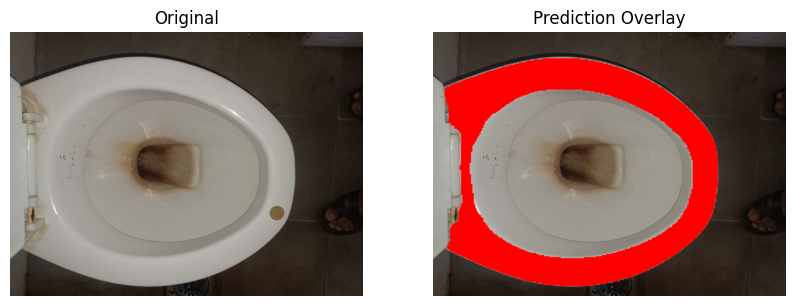

Center: (522, 511)
Angle: 88.50306701660156
First Bottom Point: (942, 522)
Last Bottom Point: (1037, 524)
First Right Point: (530, 211)
Last Right Point: (533, 91)


In [27]:
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms

# --- Setup device ---
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# --- Load and preprocess image ---
test_path = "C:/Users/saval/Downloads/toilet/test34.jpg"
test_image = cv2.imread(test_path)
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
resized = cv2.resize(test_image, (256, 256))

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])
input_tensor = transform(resized).unsqueeze(0).to(DEVICE)

# --- Predict ---
model.eval()
with torch.no_grad():
    output = model(input_tensor)
    pred = torch.sigmoid(output).squeeze().cpu().numpy()
    pred_mask = (pred > 0.5).astype(np.uint8) * 255

# --- Resize mask to original size ---
pred_mask_resized = cv2.resize(pred_mask, (test_image.shape[1], test_image.shape[0]))

# --- Overlay mask on image ---
overlay = test_image.copy()
overlay[pred_mask_resized == 255] = [255, 0, 0]

# --- Show results ---
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(test_image)
plt.title("Original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(overlay)
plt.title("Prediction Overlay")
plt.axis("off")
plt.show()

# --- Analyze mask ---

result = analyze_toilet_mask(pred_mask_resized)

print("Center:", result['center'])
print("Angle:", result['angle'])
print("First Bottom Point:", result['first_bottom'])
print("Last Bottom Point:", result['last_bottom'])
print("First Right Point:", result['first_right'])
print("Last Right Point:", result['last_right'])